In [1]:
#imports

In [2]:
import sys 
import numpy as np
import os


sys.path.append("/path/to/your/module/folder")
import datastream as ds


In [3]:
SEQ_LEN      = 64
N_FEATURES   = 8
Z_DIM        = 32

SUITS = [ 1, 2, 3 ]

name = "session_1_pt"

dataroot = os.path.join("data", name)

dataserver = ds.Dataserver(SEQ_LEN , N_FEATURES, SUITS, ["load"], dataroot = dataroot)

ch 1 | Loaded samples: 98666
ch 2 | Loaded samples: 127475
ch 3 | Loaded samples: 119607


In [4]:
%matplotlib inline
import matplotlib.pyplot as plt
plt.style.use('seaborn-whitegrid')

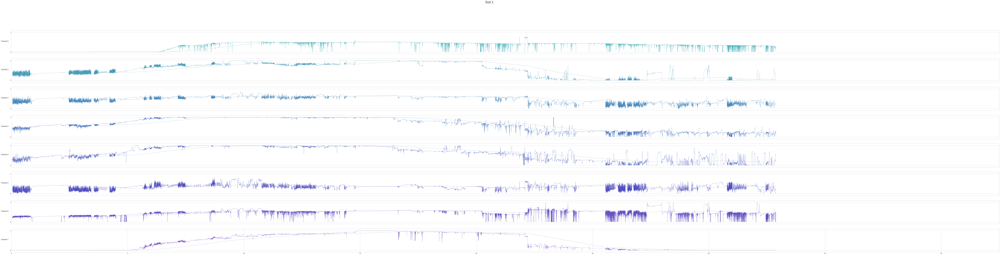

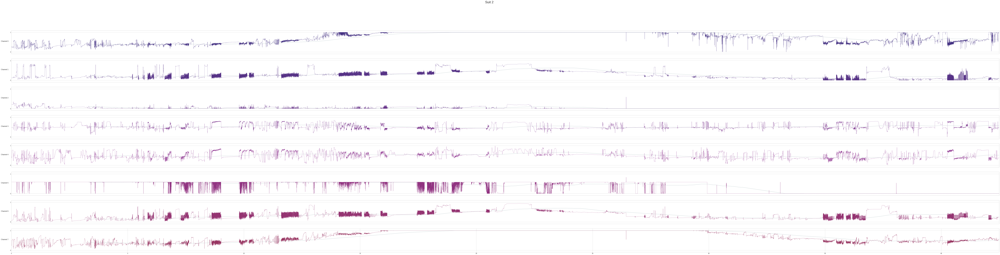

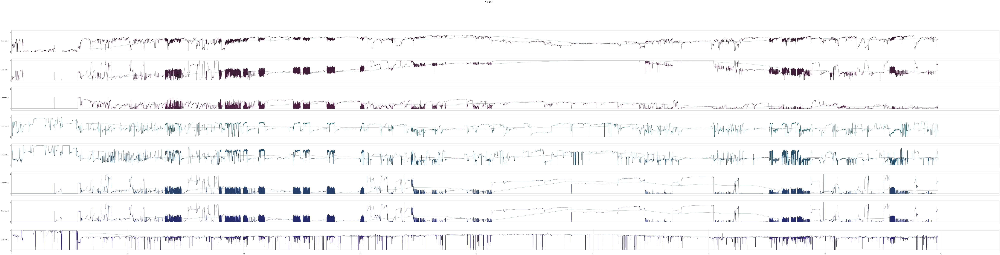

In [5]:
colors = [
    [   "#47b1b9",
        "#499dbb",
        "#4a8abd",
        "#4c76be",
        "#4e62c0",
        "#504fc1",
        "#6751c3",
        "#7e52c5",],

    [   "#453283",
        "#563286",
        "#673289",
        "#7a328c",
        "#8e338f",
        "#913381",
        "#943371",
        "#973360",],

    [   "#34192d",
        "#401d38",
        "#4d2042",
        "#246065",
        "#254f68",
        "#253e6a",
        "#262b6d",
        "#352670",]
    ]

WINDOW = 10000
TIME_CONVERSION = 20e-3 / 60


def running_mean(x, N):
    cumsum = np.cumsum(np.insert(x, 0, 0)) 
    return (cumsum[N:] - cumsum[:-N]) / float(N)

max_len = 0
for suit in SUITS:
    l = dataserver.datastreams[suit].data.shape[0]
    max_len = max(l, max_len)

for suit in SUITS:

    fig, axs = plt.subplots(8, 1, figsize=(130,30))
    fig.suptitle(f"Suit {suit}", fontsize=24)

    for ch in range(8):
        data = dataserver.datastreams[suit].data[:,ch]

        ravr = running_mean(data, WINDOW)

        axs[ch].set_ylim(-0.1, 1.1) 
        axs[ch].set_yticks([0.0, 1.0])


        axs[ch].set_xlim(0.0, max_len * TIME_CONVERSION) 
        if(ch != 7):
            axs[ch].get_xaxis().set_visible(False)

        axs[ch].set_ylabel(f"Channel {ch}", rotation=0, labelpad=40, fontsize='large') 

       

        axs[ch].plot((np.arange(ravr.size) + WINDOW)  * TIME_CONVERSION , ravr, color="#15474f", linewidth=0.5, linestyle='dashed' )
        axs[ch].plot((np.arange(data.size) * TIME_CONVERSION), data        , color=colors[suit-1][ch], linewidth=0.5 )

    plt.savefig(f'figures/figure_{suit}.svg')
    plt.savefig(f'figures/figure_{suit}.png')
